# Import Libraries

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
import tensorflow as tf
from glob import glob

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential

# Load and Explore train data

In [2]:
import pathlib
data_dir = pathlib.Path('train')

In [3]:
data_dir

PosixPath('train')

In [4]:
image_count = len(list(data_dir.glob('*/*.jpg')))
print(image_count)

7573


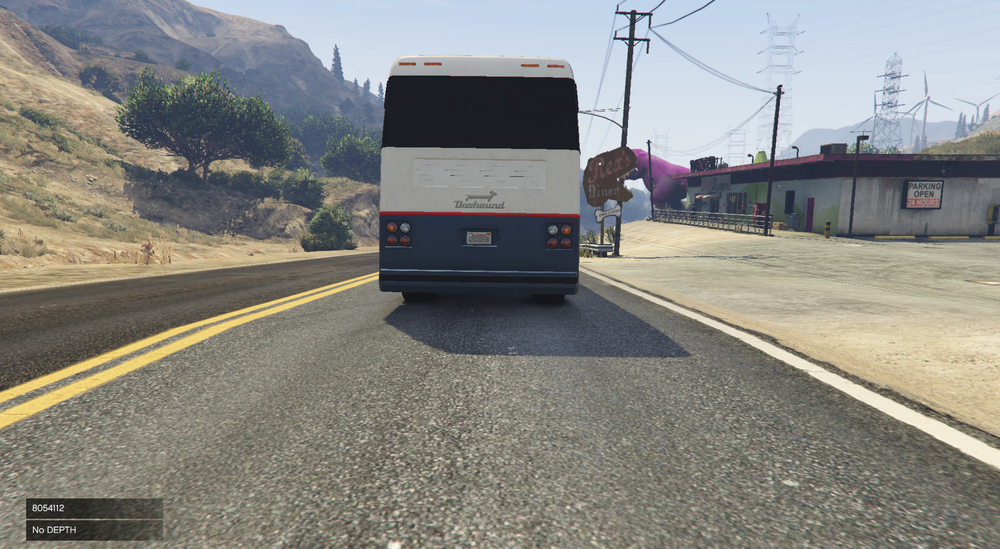

In [5]:
zero = list(data_dir.glob('0/*.jpg'))
PIL.Image.open(str(zero[0]))

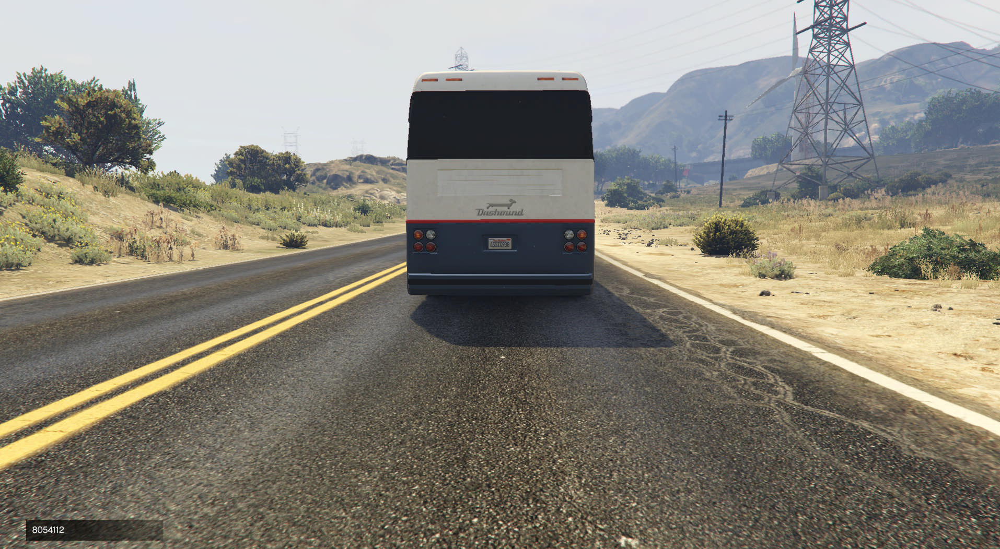

In [6]:
PIL.Image.open(str(zero[1]))

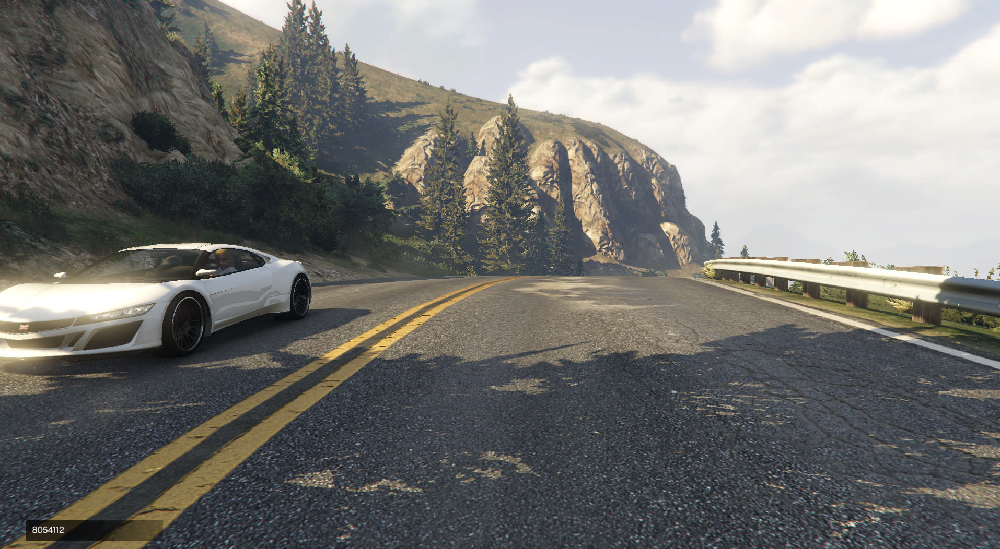

In [7]:
one = list(data_dir.glob('1/*.jpg'))
PIL.Image.open(str(one[0]))

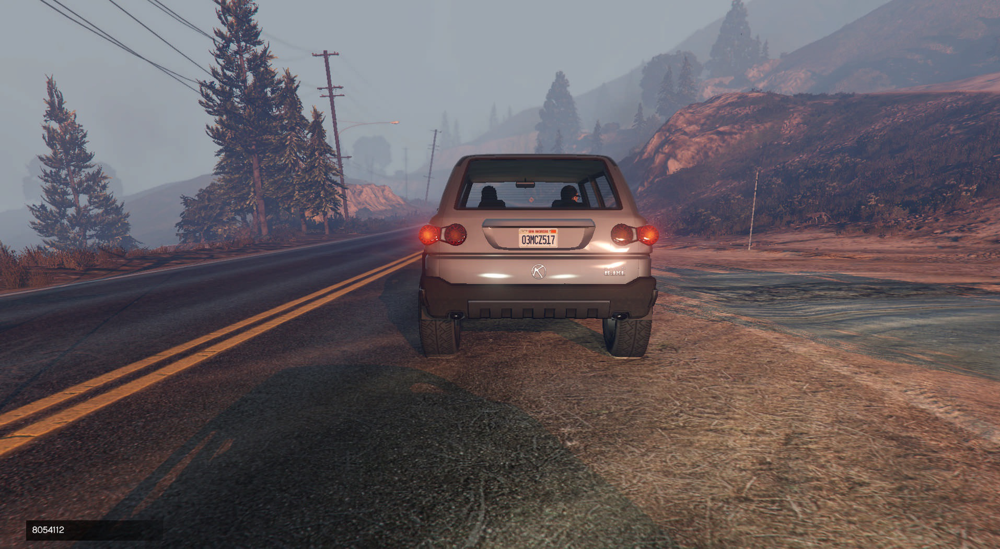

In [8]:
PIL.Image.open(str(one[1]))


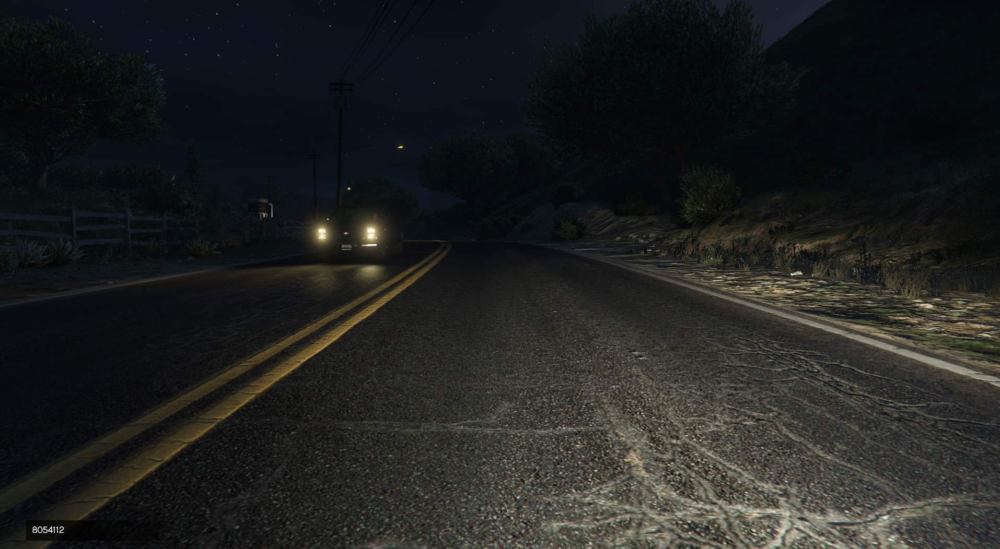

In [9]:
two = list(data_dir.glob('2/*.jpg'))
PIL.Image.open(str(two[0]))

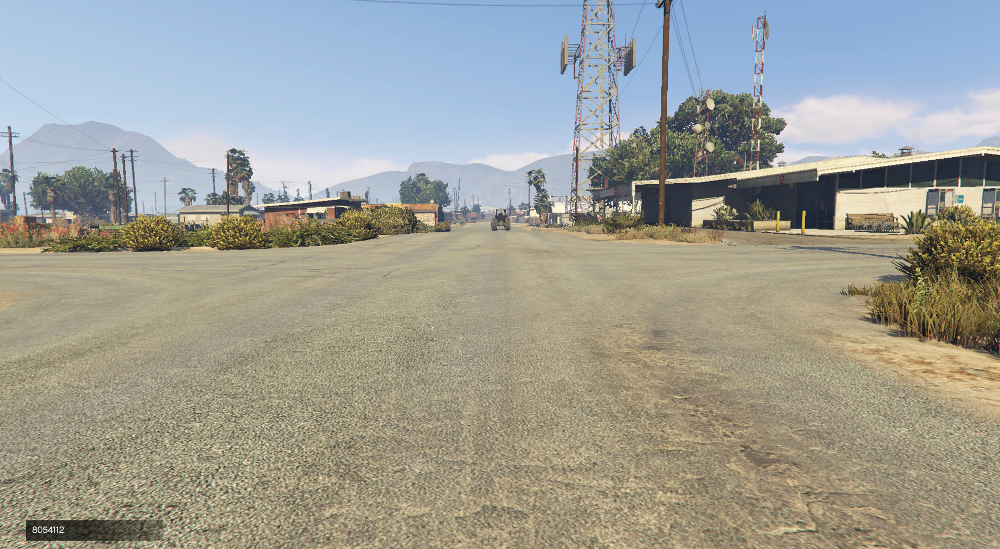

In [10]:
PIL.Image.open(str(two[1]))

# Split Train-Validation

In [11]:
batch_size = 32
img_height = 180
img_width = 180

In [12]:
train_ds = tf.keras.utils.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  subset="training",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 7573 files belonging to 3 classes.
Using 6059 files for training.
Metal device set to: Apple M1


2021-12-04 14:29:30.974631: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.2
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2021-12-04 14:29:30.979713: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2021-12-04 14:29:30.981502: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


In [13]:
val_ds = tf.keras.utils.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  subset="validation",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 7573 files belonging to 3 classes.
Using 1514 files for validation.


In [14]:
class_names = train_ds.class_names
print(class_names)

['0', '1', '2']


2021-12-04 14:29:36.086844: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


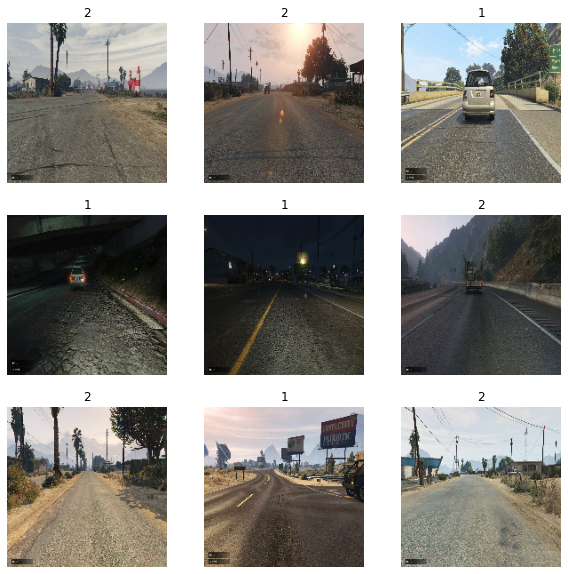

In [15]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

In [16]:
for image_batch, labels_batch in train_ds:
  print(image_batch.shape)
  print(labels_batch.shape)
  break

(32, 180, 180, 3)
(32,)


# Autotune

In [17]:
AUTOTUNE = tf.data.AUTOTUNE

train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)

# Build CNN model with Dropout

In [18]:
num_classes = 3

model = Sequential([
  layers.Rescaling(1./255, input_shape=(img_height, img_width, 3)),
  layers.Conv2D(16, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Dropout(0.6),
  layers.Conv2D(32, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Dropout(0.6),
  layers.Conv2D(64, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Dropout(0.6),
  layers.Flatten(),
  layers.Dense(128, activation='relu'),
  layers.Dense(num_classes)
])

In [19]:
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [20]:
model.summary()


Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling (Rescaling)        (None, 180, 180, 3)       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 180, 180, 16)      448       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 90, 90, 16)        0         
_________________________________________________________________
dropout (Dropout)            (None, 90, 90, 16)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 90, 90, 32)        4640      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 45, 45, 32)        0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 45, 45, 32)        0

# Train the model

In [23]:
epochs=100
history = model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

Epoch 1/30
190/190 [==============================] - 18s 95ms/step - loss: 0.0923 - accuracy: 0.9673 - val_loss: 0.4029 - val_accuracy: 0.8719
Epoch 2/30
190/190 [==============================] - 18s 94ms/step - loss: 0.0894 - accuracy: 0.9670 - val_loss: 0.3446 - val_accuracy: 0.8937
Epoch 3/30
190/190 [==============================] - 17s 88ms/step - loss: 0.0886 - accuracy: 0.9690 - val_loss: 0.4312 - val_accuracy: 0.8402
Epoch 4/30
190/190 [==============================] - 17s 92ms/step - loss: 0.1008 - accuracy: 0.9625 - val_loss: 0.3689 - val_accuracy: 0.8798
Epoch 5/30
190/190 [==============================] - 18s 93ms/step - loss: 0.0873 - accuracy: 0.9700 - val_loss: 0.3524 - val_accuracy: 0.8705
Epoch 6/30
190/190 [==============================] - 18s 95ms/step - loss: 0.0972 - accuracy: 0.9639 - val_loss: 0.3793 - val_accuracy: 0.8771
Epoch 7/30
190/190 [==============================] - 18s 94ms/step - loss: 0.0870 - accuracy: 0.9680 - val_loss: 0.3568 - val_accuracy:

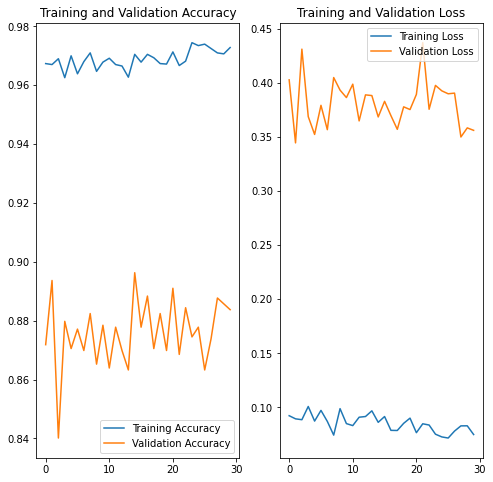

In [24]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

# Prediction

In [25]:
files = glob('{}/*/*_image.jpg'.format('test'))
files.sort()

In [26]:
import csv
name = '{}/test_labels_cnn_dpallep100.csv'.format('test')
with open(name, 'w') as f:
    writer = csv.writer(f, delimiter=',', lineterminator='\n')
    writer.writerow(['guid/image', 'label'])
    for file in files:
        guid = file.split('/')[-2]
        idx = file.split('/')[-1].replace('_image.jpg', '')
        img = tf.keras.utils.load_img(
        file, target_size=(img_height, img_width)
        )
        img_array = tf.keras.utils.img_to_array(img)
        img_array = tf.expand_dims(img_array, 0) # Create a batch

        predictions = model.predict(img_array)
        score = tf.nn.softmax(predictions[0])
        label = class_names[np.argmax(score)]
        writer.writerow(['{}/{}'.format(guid, idx), label])
    print('Wrote report file `{}`'.format(name))

2021-12-04 15:03:35.393943: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:112] Plugin optimizer for device_type GPU is enabled.


Wrote report file `test/test_labels_cnn_dpallep100.csv`
